 # Advanced Machine Learning - programming assignment 2

*Due: Friday December 12th 23:59*

**Please fill in:**
* MARC AVILA PEDEMONTE (9780637)
* ARIANNA FELIZIANI (2107848)

### Further instructions:
* Code quality is considered during the assessment (of ass 2 & 4). Make sure your code is properly commented. 
* Submit your code in BrightSpace only for ass 2 & 4.
* When you submit the code, make sure to name the submitted file according to your and your collaborators last name (i.e. submitter_collaborator.ipynb).
* Please notice that the grader most likely won't install additional packages. Try to stick with the standard library and the packages listed. 
* **Failure to follow these instructions can affect the assignment grade.**

 ## Reinforcement learning with function approximation

In this assignment, you'll design your own agent to complete an episodic MDP task following the gymnasium framework. The agent will be looking at a small part of the UU logo, and have to decide which of the four compass directions (i.e. left, right, up, down) to move in. The learning task is to find the goal in the center as soon as possible.

The learning objectives of this assignment are:
- Implement two versions of the agent using Semi-gradient SARSA and Q-Learning algorithms with a linear approximation function,
- Implement one agent using DQN algorithm (one deep RL method),
- Demonstrate the difference between on-policy and off-policy RL methods,
- Learn to integrate the approximation function with Tabular RL methods,
- Play with the important parameters, e.g. discount factor $\gamma$, stepsize $\alpha$ and update frequency in DQN; and understand their influence on the learning procedure.  


### 1. Let's start with setting up the enviroment.

The following code defines various aspects of the environment.

In [1]:
import itertools as it
from abc import ABC, abstractmethod
from collections import deque
from enum import IntEnum
import random
from typing import List, Tuple

import numpy as np
import pandas as pd
from scipy import stats


import torch
import torch.nn as nn
import torch.optim as optim

import gymnasium
from gymnasium import spaces

import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from matplotlib.backends.backend_agg import FigureCanvasAgg
from matplotlib.figure import Figure
from matplotlib.patches import Patch

from IPython import display
from IPython.display import HTML
from tqdm import tqdm

/Users/arian/opt/anaconda3/lib/python3.9/site-packages/pandas/core/computation/expressions.py:21: UserWarning: Pandas requires version '2.8.4' or newer of 'numexpr' (version '2.8.3' currently installed).
  from pandas.core.computation.check import NUMEXPR_INSTALLED
/Users/arian/opt/anaconda3/lib/python3.9/site-packages/pandas/core/arrays/masked.py:61: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (


In [2]:
# %matplotlib inline
# Constants defining the environment
GOAL = (140, 120)
CENTER = (132, 132)
AVG_MOVEMENT_SIZE = 24
ACCEPTABLE_DISTANCE_TO_GOAL = (AVG_MOVEMENT_SIZE // 2) + 1
RADIUS = 72
WINDOW_SIZE = 28
TIME_LIMIT = 200
TIMEOUT_REWARD = -100.0
MOVE_REWARD = -1
INVALID_MOVE_REWARD = -5


# This is for type inference
State = Tuple[int, int]


# Action space
class Actions(IntEnum):
    NORTH = 0
    EAST = 1
    SOUTH = 2
    WEST = 3


# Boundaries
class Boundary(IntEnum):
    WEST = CENTER[0] - RADIUS
    EAST = CENTER[0] + RADIUS
    NORTH = CENTER[1] - RADIUS
    SOUTH = CENTER[1] + RADIUS

# Augmented boundarie, not used in this assignment
class AugmentedArea(IntEnum):
    WEST = Boundary.WEST - (WINDOW_SIZE // 2)
    EAST = Boundary.EAST + (WINDOW_SIZE // 2)
    NORTH = Boundary.NORTH - (WINDOW_SIZE // 2)
    SOUTH = Boundary.SOUTH + (WINDOW_SIZE // 2)


# Image
ORIGINAL_IMAGE = plt.imread("UU_LOGO.png")
# Convert to one color channel (using only the red channel), with white background
IMAGE = ORIGINAL_IMAGE[:, :, 0] * ORIGINAL_IMAGE[:, :, 3] + (1.0 - ORIGINAL_IMAGE[:, :, 3])


# Get a "camera view" at the position indicated by state
# Use reshape=True to format the output as a data point for the neural network
def get_window(state: State, reshape=False) -> np.ndarray:
    # When indexing the image as an array, switch the coordinates: im[state[1], state[0]]
    window = IMAGE[(state[1] - 14):(state[1] + 14), (state[0] - 14):(state[0] + 14)]
    if reshape:
        return np.reshape(window, (1, 28, 28, 1))
    return window


# Is the state close enough to the goal to be considered a success?
# There is a margin for error, so that the agent can't jump over the goal
def is_goal_reached(state: State) -> bool:
    return np.amax(np.abs(np.asarray(state) - np.asarray(GOAL))) <= ACCEPTABLE_DISTANCE_TO_GOAL


# This is a helper function to render a run
def updatefig(j, images, imgplot, text_act_plot, text_reward_plot):
    # set the data in the axesimage object
    img, time_point, from_state, to_state, act, current_reward = images[min(len(images), j)]
    imgplot.set_data(img)
    text_act_plot.set_text(f"Time step: {time_point} - Action: {act}\nState: {from_state} -> {to_state}")
    text_reward_plot.set_text(f"Current total reward: {current_reward}")
    # return the artists set
    return [imgplot, text_act_plot]


# This will render a run of a full epoch
# The function needs a list of tuples containing an image array, a State, the performed action
def render_epoch(animation_data: List[Tuple[np.ndarray, State, Actions]], interval=100, blit=True, **kwargs):
    if not len(animation_data):
        return f"No images in the list"
    fig, ax = plt.subplots()
    imgplot = ax.imshow(np.zeros_like(animation_data[0][0]))
    text_act_plot = ax.set_title("", color="red", fontweight="extra bold", loc="left")
    text_reward_plot = ax.text(5, 255, "", color="red", fontweight="extra bold")
    params = [animation_data, imgplot, text_act_plot, text_reward_plot]
    ani = FuncAnimation(fig,
                        updatefig,
                        fargs=params,
                        frames=len(animation_data),
                        interval=interval,
                        blit=blit,
                        **kwargs)
    animation = HTML(ani.to_jshtml())
    plt.close()
    return display.display(animation)

# This function can be used to smooth obtained plots
def smooth(y, box_pts):
    box = np.ones(box_pts) / box_pts
    return np.convolve(y, box, mode='valid')

 The following 2 images show:
 * The original image, with a red dot marking the goal and a red rectangle marking the area where the center of agent must remain. A movement that would take the agent outside this rectangle, places him at the boundary instead. The blue rectangle represents an augmented area that is not necessary in the assignement but with which you can play.
 * What the agent sees if s/he is exactly at the goal.

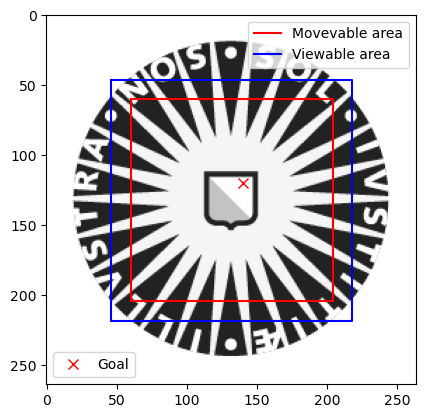

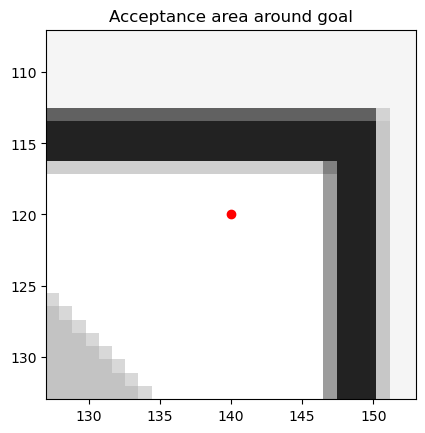

In [3]:
plt.imshow(IMAGE[:, :], cmap='gray', vmin=0, vmax=1.0)
# Plotting uses reversed y-axis now: larger y values are further down
goal_container = plt.plot(GOAL[0], GOAL[1], 'rx', markersize="7")
legend2 = plt.legend(goal_container, ["Goal"], loc=3)

plt.plot([Boundary.WEST, Boundary.WEST, Boundary.EAST, Boundary.EAST, Boundary.WEST],
         [Boundary.NORTH, Boundary.SOUTH, Boundary.SOUTH, Boundary.NORTH, Boundary.NORTH],
         'r-',
         label="Movevable area")
plt.plot([AugmentedArea.WEST, AugmentedArea.WEST, AugmentedArea.EAST, AugmentedArea.EAST, AugmentedArea.WEST],
         [AugmentedArea.NORTH, AugmentedArea.SOUTH, AugmentedArea.SOUTH, AugmentedArea.NORTH, AugmentedArea.NORTH],
         'b-',
         label="Viewable area")

plt.legend()
plt.gca().add_artist(legend2)
plt.show()

# window around goal
img_container = plt.imshow(get_window(GOAL),
                           cmap='gray',
                           vmin=0,
                           vmax=1.0,
                           extent=(GOAL[0] - ACCEPTABLE_DISTANCE_TO_GOAL, GOAL[0] + ACCEPTABLE_DISTANCE_TO_GOAL,
                                   GOAL[1] + ACCEPTABLE_DISTANCE_TO_GOAL, GOAL[1] - ACCEPTABLE_DISTANCE_TO_GOAL))
plt.plot(GOAL[0], GOAL[1], 'ro', linewidth=1)
plt.title("Acceptance area around goal")
plt.show()



The following class provides the functionality of tile encoding. The implementation can be used to define multiple tilings. The default code uses three tilings. You can play with different number of tilings, but please deliver the results with only one setting with multiple tilings.  


Samples:
[[ 16.6609363   12.59265074]
 [225.02515618 134.49822605]
 [153.09963055 128.9264012 ]
 [ 51.4491125   52.40080192]
 [184.20907419 159.44209518]]

Indexes of samples:
[[0, 0], [0, 0], [0, 0]]
[[8, 5], [8, 3], [8, 4]]
[[6, 4], [5, 3], [7, 3]]
[[0, 0], [0, 0], [0, 0]]
[[8, 6], [7, 5], [8, 5]]


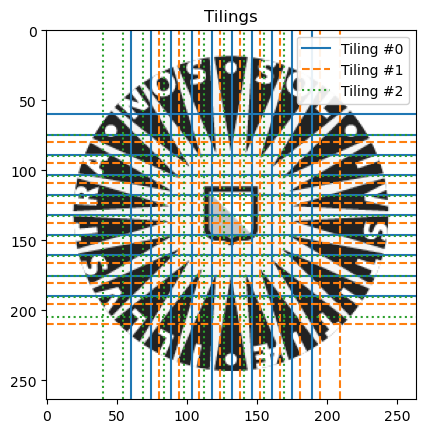

In [4]:
class grid_tilings():
    def __init__(self, number_of_grids = 1, offsets = np.array([[0.0, 0.0]]), bins_per_dim = (9, 9)) -> None:
        # Low value for each dimension, for each grid / tile
        lows = np.array([[Boundary.NORTH, Boundary.WEST]]*number_of_grids)
        # High value for each dimension, for each grid / tile
        highs = np.array([[Boundary.SOUTH, Boundary.EAST]]*number_of_grids)
        # Number of discrete bin for each each dimension, for each grid / tile
        bins = np.array([bins_per_dim] * number_of_grids)
        # The offset is used to setup the overlap of grids
        # offsets = np.array([[0.0, 0.0]]) is one grid starting from lows to highs 
        # offsets = np.array([[20.0, 20.0]]) is one grid starting from lows+[20.0, 20.0] to highs+[20.0, 20.0]

        self.grids = []

        for l, h, b, o in zip(lows, highs, bins, offsets):
            grid = {}
            grid['size']  = b
            grid['low'] = l
            grid['offset'] = o
            grid['points'] = []
            grid['step'] = []
            for dim in range(len(b)):
                points, step = np.linspace(l[dim], h[dim], b[dim]+1, endpoint=False, retstep=True)
                points += o[dim]
                grid['points'].append(points)
                grid['step'].append(step)

            grid['step'] = np.array(grid['step'])
            grid['weights'] = np.zeros(grid['size'])
            self.grids.append(grid)

    # Get the sum of the weights for given continuous coordinates
    def get_weight(self, sample):
        encoded_sample = self.tile_encode(sample)
        w = 0.0
        for grid, (x,y) in zip(self.grids, encoded_sample):
            w += grid['weights'][x,y]
        return w
    
    # Set the weights for given continuous coordinates
    def set_weight(self, sample, target):
        encoded_sample = self.tile_encode(sample)
        for grid, (x,y) in zip(self.grids, encoded_sample):
            grid['weights'][x,y] = target/len(self.grids)

    # Return the discrete coordinates from continuous coordinates for all grids
    def tile_encode(self, sample):
        encoded_sample = []
        for grid in self.grids:
            encoded_sample.append(self.discretize(sample, grid))
        return encoded_sample    
    
    # Return the discrete coordinates from continuous coordinates for a given grid
    def discretize(self, sample, grid):
        sample = np.array(sample) - (grid['low'] + grid['offset'])
        sample = np.maximum(sample, np.array([0]*len(grid['size'])))
        index = sample // grid['step']
        index = np.minimum(index, grid['size']-1)
        return list(index.astype(int))

    # Plot the different grids
    def visualize_tilings(self):
        """Plot each tiling as a grid."""
        prop_cycle = plt.rcParams['axes.prop_cycle']
        colors = prop_cycle.by_key()['color']
        linestyles = ['-', '--', ':']
        legend_lines = []
        
        for i, grid in enumerate(self.grids):
            for x in grid['points'][0]:
                l = plt.axvline(x=x, color=colors[i % len(colors)], linestyle=linestyles[i % len(linestyles)], label=i)
            for y in grid['points'][1]:
                l = plt.axhline(y=y, color=colors[i % len(colors)], linestyle=linestyles[i % len(linestyles)])
            legend_lines.append(l)
        plt.legend(legend_lines, ["Tiling #{}".format(t) for t in range(len(legend_lines))], facecolor='white', framealpha=0.9)
        plt.title("Tilings")


# default setting for 3 tilings:
offsets = np.array([[0.0, 0.0], [20.0, 20.0], [-20.0, 15.0]])
tilings = grid_tilings(3, offsets)

# example for one tiling
# tilings = grid_tilings()

plt.imshow(IMAGE[:, :], cmap='gray', vmin=0, vmax=1.0)
tilings.visualize_tilings()

# Test with some sample values
samples = np.random.rand(5, 2) * 264
print("\nSamples:", samples, sep="\n")
encoded_samples = [tilings.tile_encode(sample) for sample in samples]
print("\nIndexes of samples:", *[s for s in encoded_samples], sep="\n")

 The following functions complete the definition of the environment. The agent's movements always go in the intended direction, but the distance travelled has a small random component. Besides by reaching the goal, the episode also terminates after TIME_LIMIT (200) steps; at that point, the agent gets a negative reward TIMEOUT_REWARD.

In [5]:
class Environment(gymnasium.Env):
    metadata = {'render.modes': ['human', 'rgba_array']}
    bx = np.array([AugmentedArea.WEST, AugmentedArea.WEST, AugmentedArea.EAST, AugmentedArea.EAST, AugmentedArea.WEST])
    by = np.array([AugmentedArea.NORTH, AugmentedArea.SOUTH, AugmentedArea.SOUTH, AugmentedArea.NORTH, AugmentedArea.NORTH])

    def __init__(self):
        self.num_actions = Actions
        self.action_space = spaces.Discrete(len(self.num_actions))
        self.observation_space = spaces.Discrete(1)
        self.display = None
        self.img, self.img_container = Environment._init_visual_area(IMAGE)
        self.time = 0

    def seed(self, seed=None) -> int:
        np.random.seed(seed)
        return seed

    def step(self, action: Actions):
        assert self.action_space.contains(action)
        (x, y), was_invalid = self._validate_state(self._move(self.state, action))

        self.state = (x, y)
        reward = MOVE_REWARD if not was_invalid else INVALID_MOVE_REWARD
        reward = TIMEOUT_REWARD if self.time >= TIME_LIMIT else reward
        reward = self.time * reward
        done = is_goal_reached(self.state) or self.time >= TIME_LIMIT
        self.time += 1
        return self.state, reward, done, {}

    def reset(self, state: State = None) -> State:
        self.state = self.starting_state() if not state else state
        self.time = 0
        return self.state

    # returns the current environment situation
    def render(self, mode='rgba_array'):
        curr_img = np.array(self.img_container.get_array())
        x, y = self.state
        scaler = 4
        w, e, n, s = x - scaler, x + scaler, y - scaler, y + scaler
        curr_img[n:s, w:e, 0] = 255
        curr_img[n:s, w:e, 1] = 0
        curr_img[n:s, w:e, 2] = 255
        curr_img[n:s, w:e, 3] = 255
        cropped_img = curr_img  # Just for debugging purposes
        if mode == 'rgba_array':
            plt.close()
            return cropped_img  # return RGB frame suitable for video
        elif mode == 'human':
            container = plt.imshow(curr_img)
            ax = container.axes
            ax.set_xlim(Boundary.WEST, Boundary.EAST, auto=None)
            ax.set_ylim(Boundary.SOUTH, Boundary.NORTH, auto=None)
            return container
        else:
            raise Exception(f"Please specify either 'rgba_array' or 'human' as mode parameter!")

    # Return a randomly chosen non-terminal state as starting state
    def starting_state(self) -> State:
        while True:
            state = (
                np.random.randint(Boundary.WEST, Boundary.EAST + 1),
                np.random.randint(Boundary.NORTH, Boundary.SOUTH + 1),
            )
            if not is_goal_reached(state):
                return state

    @staticmethod
    def _move(state: State, action: Actions) -> State:
        x, y = state
        if action == Actions.NORTH:
            y -= AVG_MOVEMENT_SIZE + np.random.randint(5) - 2
        elif action == Actions.SOUTH:
            y += AVG_MOVEMENT_SIZE + np.random.randint(5) - 2
        elif action == Actions.WEST:
            x -= AVG_MOVEMENT_SIZE + np.random.randint(5) - 2
        elif action == Actions.EAST:
            x += AVG_MOVEMENT_SIZE + np.random.randint(5) - 2
        return x, y

    @staticmethod
    def _validate_state(state: State) -> Tuple[State, bool]:
        x, y = state
        is_invalid = False
        if y < Boundary.NORTH:
            is_invalid = True
            y = int(Boundary.NORTH)
        if y > Boundary.SOUTH:
            is_invalid = True
            y = int(Boundary.SOUTH)
        if x < Boundary.WEST:
            is_invalid = True
            x = int(Boundary.WEST)
        if x > Boundary.EAST:
            is_invalid = True
            x = int(Boundary.EAST)
        return (x, y), is_invalid

    @staticmethod
    def _init_visual_area(img) -> np.ndarray:
        x, y = img.shape
        my_dpi = 80
        fig = Figure(figsize=(y / my_dpi, x / my_dpi), dpi=my_dpi)
        canvas = FigureCanvasAgg(fig)
        ax = fig.gca()

        ax.plot(GOAL[0], GOAL[1], 'ro', linewidth=5)
        ax.plot(Environment.bx, Environment.by, 'b-')
        img_container = ax.imshow(img[:, :], cmap='gray', vmin=0, vmax=1.0)
        ax.axis('off')
        fig.tight_layout()
        canvas.draw()  # draw the canvas, cache the renderer
        s, (width, height) = canvas.print_to_buffer()
        image = np.frombuffer(s, np.uint8).reshape((height, width, 4))
        img_container.set_data(image)
        plt.close()
        return image, img_container



### 2. Implement your agent for Semi-gradient SARSA and Q-Learning

Next comes your part. We start with integrating the linear approximation function with Tabular RL methods. 

**2.1** The following class is responsible for the agent's behavior. The select_action function should implement the epsilon-greedy policy, and return an action chosen according to that policy. **Please fill in the missing codes in select_action function (1.5 points).** 

 Remark: This is an abstract class.
 Hence, its sole purpose is creating subclasses from it, which is also the reason it cannot be instantiated.
 The following subsequent subclasses will provide a specific implementation for the methods that are missing here.
 Therefore, you can ignore the functions that are not implemented. This is just a common way to make sure that all subclasses behave similarly.

In [6]:
class Agent(ABC):
    def __init__(self, alpha: float, gamma: float, epsilon: float):
        # set up the value of epsilon
        self.alpha = alpha  # learning rate or step size
        self.gamma = gamma  # discount factor
        self.epsilon = epsilon  # exploration rate
        self.hist = []

    # Choose action at state based on epsilon-greedy policy and valueFunction
    def select_action(self, state: Tuple[int, int], use_greedy_strategy: bool = True) -> int:

        # TO BE FILLED (1.5 points)
        
        # First it has to be assumed that a list with the q-values for each (state-action) pair will be provided (if not one can not implement epsilon greedy decision making)
        # But using Function Approximation, and taking a look at the methods that the real agents (watching the codes below) provide
        # what will be provided is a list of all the values for one particular state, and all their possible actions
        # this would be a function of state and action that returns a value depending on the input state and input action,
        # and the state has already been selected so the remaining thing to consider is the action
        values = self.values(state) # this function values(state) returns a vector of a single row (state determined)
                                      # and as many columns as possible actions exist, with their q-values for that state
        
        # List with all the possible actions
        actions = [0,1,2,3] # same as defining actions = np.arange(len(values))    

        
        # Using or not the greedy strategy depending on the input variable of the function
        if use_greedy_strategy == True:
            # Searching the maximum q-value of the values for this state
            max_q_value = max(values)
            
            # Only considering the action (or multiple if they draw)
            best_actions = [action for action, q in enumerate(values) if q == max_q_value]
        
        
        # Using the epsilon greedy strategy:
        elif use_greedy_strategy == False:
        
            # Generate a random uniform number to decide if greedy action or random action is selected in this step (run = call of this agent)
            u = np.random.uniform(0,1)

            # Greedy action: select with probab (1-eps) the best possible action to take in the situation of being in this particular state
            if u <= (1 - self.epsilon):
                # Searching the maximum q-value of the values for this state
                max_q_value = max(values)
                # Keeping the action that gives the best (higher) q-value in this state
                best_actions = [action for action, q in enumerate(values) if q == max_q_value] # the list only will have the maximal q value actions which will be then 100% sure picked in the return of the function

            # Random action: select with probab (eps) one among all possible actions randomly
            elif u > (1 - self.epsilon):
                best_actions = actions # the function in the return will pick randomly one among all possible


        self.hist.append(values)
        return int(np.random.choice(best_actions))

    # Return estimated action value of given state and action
    @abstractmethod
    def value(self, state: State, action: Actions) -> float:
        pass

    # Return vector of estimated action values of given state, for each action
    @abstractmethod
    def values(self, state: State) -> np.ndarray:
        pass

    # Set value for given state and action
    @abstractmethod
    def set_value(self, state: State, action: Actions):
        pass
    
    # learn with given state, action and target
    # different between on-policy and off-policy
    @abstractmethod
    def learn(self, state: State, action: Actions, next_state: State, reward: float, done: bool = False) -> int:
        return None

    # Return estimated state value, based on the estimated action values
    def state_value(self, state):
        return np.max(self.values(state))

    # Plot the state value estimates. Use a larger stride for lower resolution.
    def plot_state_values(self, stride=1):
        self.v = np.zeros(
            ((Boundary.SOUTH - Boundary.NORTH + stride) // stride, (Boundary.EAST - Boundary.WEST + stride) // stride))
        for j, x in enumerate(range(Boundary.WEST, Boundary.EAST + 1, stride)):
            for i, y in enumerate(range(Boundary.NORTH, Boundary.SOUTH + 1, stride)):
                self.v[i, j] = self.state_value((x, y))

        plt.imshow(self.v)
        plt.colorbar()
        return plt.show()

    def plot_q_values(self, skip=1):
        return pd.DataFrame(self.hist[::skip]).plot()



**2.2** The next classes are two agents using either episodic semi-gradient Q-Learning and episodic semi-gradient SARSA algorithm to estimate the value function. Both agents use the same linear function approximation method with tile coding. **Implement the `learn` function according to the update rule for the respective algorithm (1 point for each)**. 
 
 REMARK: Both agents use the same tile coding. This method helps splitting the state-space into discrete chunks. Each chunk is associated with one weight.

In [7]:
# This class handles the function approximation, with several methods to query and update it. 
# A linear approximation function is used, making the computation much faster.
class QAgent(Agent):
    def __init__(self, alpha: float, gamma: float, epsilon: float, num_tilings: int = 3, bins_per_dim: tuple = (9, 9)):
        super().__init__(alpha, gamma, epsilon)
        # Use a tile coding
        self.tilings = [grid_tilings(number_of_grids=num_tilings, bins_per_dim=bins_per_dim) for a in Actions]

    # Return estimated action value of given state and action
    def value(self, state, action):
        if is_goal_reached(state):
            return 0.0
        return self.tilings[action].get_weight(state)

    # Return vector of estimated action values of given state, for each action
    def values(self, state):
        if is_goal_reached(state):
            return np.zeros(4)
        return [self.tilings[action].get_weight(state) for action in Actions]
    
    # Set value for given state and action
    def set_value(self, state: State, action: Actions, value: float):
        self.tilings[action].set_weight(state, value)
    
    # learn with given state, action and target
    # different between on-policy and off-policy: for Qlearning, the agent does not need to return the next selected action
    def learn(self, state: State, action: Actions, next_state: State, reward: float, done: bool = False):
        # TO BE FILLED (1 point)
        current_q = self.value(state, action)
        if done == True:
            td_target = reward
        else:
            next_q = []
            for a in Actions:
                next_q.append(self.value(next_state, a))
            next_q_value = max(next_q)
            td_target = reward + (self.gamma * next_q_value)
        new_q = current_q + self.alpha * (td_target - current_q)
        self.set_value(state, action, new_q)
        if done:
            return 0
        return self.select_action(next_state, use_greedy_strategy = False)
        #raise NotImplementedError


In [8]:
class SARSAAgent(Agent):
    def __init__(self, alpha: float, gamma: float, epsilon: float, num_tilings: int = 3, bins_per_dim: tuple = (9, 9)):
        super().__init__(alpha, gamma, epsilon)

        # Use a tile coding
        self.tilings = [grid_tilings(number_of_grids=num_tilings, bins_per_dim=bins_per_dim) for a in Actions]

    # Return estimated action value of given state and action
    def value(self, state, action):
        if is_goal_reached(state):
            return 0.0
        return self.tilings[action].get_weight(state)

    # Return vector of estimated action values of given state, for each action
    def values(self, state):
        if is_goal_reached(state):
            return np.zeros(4)
        return [self.tilings[action].get_weight(state) for action in Actions]

    # Set value for given state and action
    def set_value(self, state: State, action: Actions, value: float):
        self.tilings[action].set_weight(state, value)
        
    # learn with given state, action and target
    # different between on-policy and off-policy: for SARSA, the agent needs to return the next selected action
    def learn(self, state: State, action: Actions, next_state: State, reward: float, done: bool = False):
        # TO BE FILLED (1 point)
        current_q = self.value(state, action)
        if done == True:
            # Target of the SARSA update rule in this case (case we reach the final state and no more "next state q values we have so far" are needed)
            td_target = reward
            # Next action to take (it is what the function needs to return)
            next_action = 0
        # In case we have not reached the terminal state with our state, action, we keep the normal procedure for updating
        else:
            # Choose the action for the next state (next action), using the function defined above that uses the epsilon greedy strategy 
            next_action = self.select_action(next_state, use_greedy_strategy = False)
            # Search the q-value that we have so far (the most recent q-value we have using our function) for the pair (next state, next action) to be able to compute it in the update rule of the algorithm
            next_q = self.value(next_state, next_action)
            # Target of the SARSA update rule
            td_target = reward + (self.gamma * next_q)
        # General Update Rule formula
        new_q = current_q + (self.alpha)*(td_target - current_q)
        
        # Save the updated q-value with the applied rule to the function (basically updating the weights of the function that cover this space for this particular action, with the new updated q-value)
        self.set_value(state, action, new_q) # there is a function defined that does exactly this
        return next_action
        #raise NotImplementedError


 The following function handles the interaction between agent and environment for a single episode. By passing the same value_function object in multiple calls to this function, the agent can learn from a sequence of such interactions.

 **Please fill in the missing parts (1 point).** 

In [9]:
# env: Environment in which the agent is supposed to run 
# agent: agent to learn
# initital state: Starting state for the environment
# is_learning: should the value function be updated during the simulation?
# is_rendering: should the run be recorded? (Takes some time to compute)


def run_episode(env: Environment,
                agent: Agent,
                initial_state: State,
                is_learning: bool = True,
                is_rendering: bool = False) -> Tuple[State, float]:
    # Initialize reward for episode
    total_reward = 0.0
    # Initialize the policy (if is_greedy=True then the agent follows its optimal policy, otherwise it will randomly select an action)
    is_greedy = not is_learning
    # Get initial action
    current_state = initial_state
    current_action = agent.select_action(initial_state, use_greedy_strategy=is_greedy)

    # Track the rendering
    animation_data = []
    animation_data.append((env.render(), env.time, None, current_state, None, 0))
    # Initialize variables
    next_state = None
    done = False
    next_action = None
    while not done:
        # TO BE FILLED
        next_state, reward, done, _ = env.step(current_action)

        total_reward += reward
        if is_rendering:
            curr_img = env.render()
            animation_data.append((curr_img, env.time, current_state, next_state, current_action, total_reward))
        
        # Execute the learning and update the state and action
        # TO BE FILLED (1 point)
        if is_learning:
            next_action = agent.learn(current_state, current_action, next_state, reward, done)
        else: 
            next_action = agent.select_action(next_state, use_greedy_strategy = is_greedy)
        
        current_state = next_state
        # if done: 
        #     break
        current_action = next_action

    agent.last_action = None
    return current_state, total_reward, animation_data


 To help understand your agent, you can render the agent's performance by setting render to True and running the `run_epoch` function. 
 
 There are some helper functions. They might help you implement the agent correctly. 
 * `agent.plot_state_values` shows you how the agent values different states
 * `agent.plot_q_values` shows the q_values that the agent had over the course of his life time. (That could be a lot. There's a skip parameter to reduce the amount of data points)

 REMARK: Keep in mind, the following is just one example run. Don't expect the model to be fully trained after just one episode. The training part follows in the next section.

(164, 75)
(133, 129)


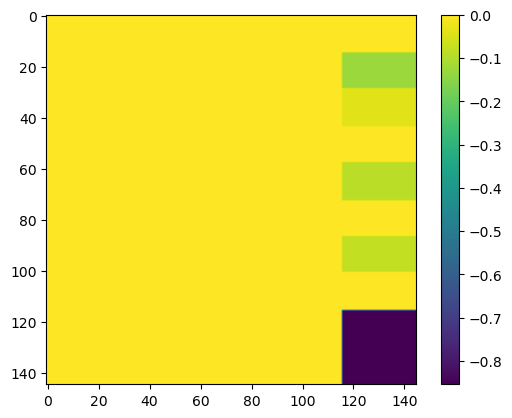

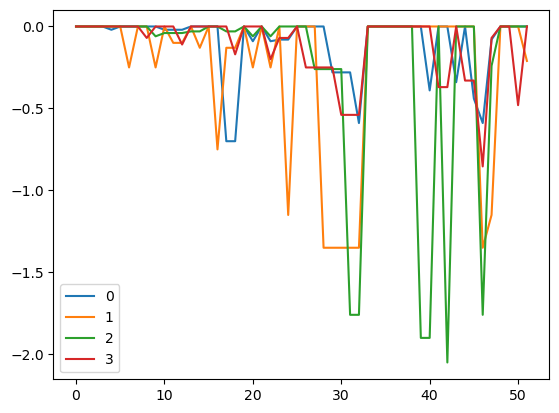

In [98]:
env = Environment()
epsilon = 0.0
gamma = .7
alpha = 1e-2
agent = QAgent(alpha, gamma, epsilon)
#agent = SARSAAgent(alpha, gamma, epsilon)
start_state = env.reset()
print(start_state)
end_state, total_reward, animation_data = run_episode(env, agent, start_state, is_learning=True, is_rendering=True)
print(end_state)
agent.plot_state_values()
agent.plot_q_values(skip=1)
render_epoch(animation_data, interval=100)


### 3. Run the simulation, play with parameters and analyse results

 Now it's time to train both algorithms/agents on the environment. 
 
 In the simulations, please plot the measure of each algorithm's performance as a function of the episode (i.e. the sum of all immediate rewards received in each episode). You shall play with a few combinations of two parameters discount factor $\gamma$ and stepsize $\alpha$ (at least two variables for each parameter). During the experiments, keep $\epsilon$ fixed at $0.01$. A reasonable starting point for $\alpha$ is 1e-2. 
 
 REMARK: You can save the parameters and update-to-date Q table of each agent, so that you can still test their performance later. (You can achieve this by keeping the object.)
 

**3.1 Please submit your code as well as the plots presenting compariable performance of the different combinations of parameters for every algorithms (2 points)**. 

REMARK: For a decent comparison all agents should be plotted on the same axis bounds. Also, the plots may be hard to interpret because of the scales. Feel free to do your own smoothing or use the `smooth` function provided in the beginning.

In [10]:
# Your code here for running the simulation and ploting the sum of immediate reward in each episode.

# Init the environment and run Q-Learning & SARSA

# Save and plot the results

# TO BE FILLED.

def run_simulation(Agent, env, gammas, alphas, epsilon, n_episodes):
    """
    Function to run the simulaition for possibly multiple values of gamma and alpha.
    param agent: agent 
    param env: environment
    param gammas: list of values for gamma
    param alphas: list of values for alpha
    param epsilon: float value of epsilon 
    param n_episodes: number of episodes to consider
    returns: dictionary containing rewards for each combination of gamma and alpha and on containing the trained agents
    """
    agent_rewards = {}
    tested_agents = {}
    for gamma in gammas:
        for alpha in alphas:
            agent = Agent(alpha, gamma, epsilon)
            # Create list of rewards for specific agent
            episode_rewards = []
            for episode in range(n_episodes):
                start_state = env.reset()
                end_state, total_reward, animation_data = run_episode(env, agent, start_state, is_learning = True, is_rendering = False)
                episode_rewards.append(total_reward)
            agent_rewards[(gamma, alpha)] = episode_rewards
            tested_agents[(gamma, alpha)] = agent
            print(f"Simulation ended for Agent {Agent.__name__[:-5]} with parameters γ = {gamma} and α = {alpha}. ")
    return agent_rewards, tested_agents

#Set up the values
gammas = [0.3, 0.7, 0.95]
alphas = [0.1, 0.01, 0.005] 
epsilon = 0.01
n_episodes = 1500

sarsa_rewards, sarsa_agents = run_simulation(SARSAAgent, Environment(), gammas, alphas, epsilon, n_episodes)
q_rewards, q_agents = run_simulation(QAgent, Environment(), gammas, alphas, epsilon, n_episodes)

Simulation ended for Agent SARSA with parameters γ = 0.3 and α = 0.1. 
Simulation ended for Agent SARSA with parameters γ = 0.3 and α = 0.01. 
Simulation ended for Agent SARSA with parameters γ = 0.3 and α = 0.005. 
Simulation ended for Agent SARSA with parameters γ = 0.7 and α = 0.1. 
Simulation ended for Agent SARSA with parameters γ = 0.7 and α = 0.01. 
Simulation ended for Agent SARSA with parameters γ = 0.7 and α = 0.005. 
Simulation ended for Agent SARSA with parameters γ = 0.95 and α = 0.1. 
Simulation ended for Agent SARSA with parameters γ = 0.95 and α = 0.01. 
Simulation ended for Agent SARSA with parameters γ = 0.95 and α = 0.005. 
Simulation ended for Agent Q with parameters γ = 0.3 and α = 0.1. 
Simulation ended for Agent Q with parameters γ = 0.3 and α = 0.01. 
Simulation ended for Agent Q with parameters γ = 0.3 and α = 0.005. 
Simulation ended for Agent Q with parameters γ = 0.7 and α = 0.1. 
Simulation ended for Agent Q with parameters γ = 0.7 and α = 0.01. 
Simulation

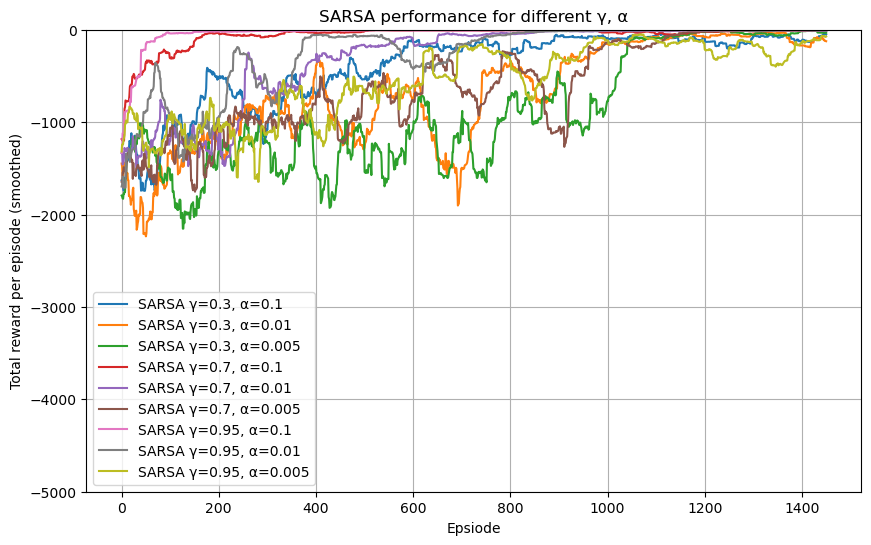

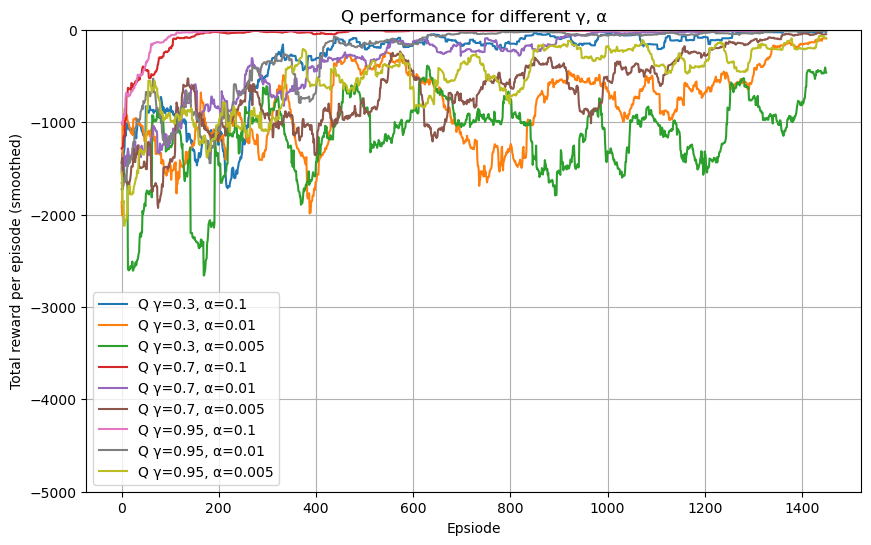

In [139]:
def plot_simulation(agent_rewards, Agent):
    """
    Function to plot the values of the simulation for each agent.
    param agent_rewards: dict of agent rewards for each (gamma, alpha) combination 
    param Agent: agent
    """
    plt.figure(figsize = (10,6))
    for (gamma, alpha), rewards in agent_rewards.items():
        box_pts = 50
        smoothed = smooth(rewards, box_pts)
        plt.plot(smoothed, label = f"{Agent.__name__[:-5]} γ={gamma}, α={alpha}")
    plt.xlabel("Epsiode")
    plt.ylabel("Total reward per episode (smoothed)")
    plt.title(f"{Agent.__name__[:-5]} performance for different γ, α")
    plt.ylim(-5000, 0)
    plt.legend()
    plt.grid(True)
    plt.show()

plot_simulation(sarsa_rewards, SARSAAgent)
plot_simulation(q_rewards, QAgent)

Put your plots here. (In case your code takes too long to run.) 

**3.2 Please interpret the results/plots (2 points)**. 

Explain what the results say about the parameters alpha (learning rate) and gamma (decay-rate), and their effects on learning.

The figures show the learning performance of SARSA and Q-learning agents trained with different combinations of the discount factor
$\gamma \in \{0.3, 0.7, 0.95\}$ and learning rate
$\alpha \in \{0.1, 0.01, 0.005\}$, while keeping the exploration rate fixed at $\varepsilon = 0.01$.
Each curve represents the smoothed total accumulated reward per episode, where higher values (closer to zero) indicate better performance and a more efficient learned policy.

Across both algorithms, the learning rate $\alpha$ has a dominant effect on the speed of learning.
Agents trained with $\alpha = 0.1$ consistently learn faster than those using smaller step sizes, rapidly improving their accumulated reward and converging toward stable performance. This behavior is clearly visible in both SARSA and Q-learning, where the corresponding curves in <font color = 'red'> red </font> and <font color = 'pink'> pink </font> rise quickly and remain close to the top of the plot throughout training. The only exception is the <font color = 'lightblue'> blue </font> line that does not rise as quickly due to the low value of $\gamma$. 

Agents using $\alpha = 0.01$ exhibit a slower but still effective learning process. These configurations improve more gradually and require more episodes to approach the performance achieved with higher learning rates. In both graphs, these curves (<font color="grey"> grey </font> and <font color="purple"> purple </font>) eventually converge but tend to show increased variability during training. Like in the case of $\alpha = 0.1$, however, the <font color = 'orange'> orange </font> line is an exception due to the low $\gamma$ parameter. 

The slowest learning behavior is observed for agents trained with $\alpha = 0.005$. For both SARSA and Q-learning, the <font color = 'brown'> brown </font>, <font color = 'lightgreen'> light green </font> and <font color = 'green'> green </font> curves remain lower for a large portion of the training and show slower improvement, indicating that the step size is too small for the agent to efficiently update its value estimates within the available number of episodes.

The discount factor $\gamma$ mainly influences the quality and stability of the learned policy, rather than the initial learning speed.
In both SARSA and Q-learning, higher values of $\gamma$ (especially $\gamma = 0.95$) generally lead to better long-term performance (as in lines <font color = 'pink'> pink </font>, <font color = 'grey'> grey </font> and <font color = 'lightgreen'> light green </font>), as the agent places more emphasis on future rewards and is better able to plan toward the goal.
Lower values of $\gamma$ (e.g., $\gamma = 0.3$) still allow learning, particularly when combined with a sufficiently large $\alpha$ (for example in lines <font color = 'lightblue'> blue </font>), but often result in noisier learning curves and slightly worse final performance as it is visible, for example, in the <font color = 'green'> green </font> line.

Overall, the results show that $\alpha$ primarily controls how fast the agent learns, $\gamma$ primarily influences how well the agent evaluates long-term consequences and that the most effective configuation for both algorithms have a high learning rate ($\alpha = 0.1$) with a high discount factor ($\gamma = 0.7$ or $\gamma = 0.95$). With one of these configurations, it is possible to achieve a good balance between learning speed, stability and final performance.


**3.3 Let us think one step further by looking at the policies you have learned (1.5 points).** 

Please compare the performance of your learned optimal policies using another simulation. In this simulation, you shall have three agents (Qlearning_Agent, SARSA_agent and Random_agent), where all three agents always use their learned policy to behave and find the goal in the given map (make sure the agent does NOT learn anymore!). The initial policies of Qlearning_Agent and SARSA_agent are the optimal policies learned from the above experiments (based on the final estimated Q-values using Q-Learning and SARSA algorithm respectively). The inital policy of Random_Agent will select 4 actions randomly. 

Describe the performance of three agents by running each agent on the task and discuss the results (1.5 points). You can use the render function provided above (and other helper functions) observe the different behaviors of three agents. You could also use an appropriate plot to show the different performances. **There is no need to submit your codes for this question.**

Some questions you shall think about and answer (in case there are no differences or no special things, just indicate what you observed):
- How does the learned Q-Learning policy and SARSA policy perform differently? Does it show the difference between on-policy and off-policy methods?
- What kind of strategy did the two RL agents learn similarly? How do they differ from the random policy?

In [22]:
# Define a random agent
class RandomAgent(Agent):
    def __init__(self):
        # Call the init method with whatever parameters (they will not be used for anything)
        super().__init__(alpha=0.0, gamma=0.0, epsilon=1.0)

    # Key functionality: return a random action between the possible options {0,1,2,3} without taking anything else into acount
    def select_action(self, state: Tuple[int, int], use_greedy_strategy: bool = True) -> int:
        action = np.random.choice([0, 1, 2, 3])
        # For compatibility reasons with plot_q_values function, save something in the hist
        self.hist.append([0, 0, 0, 0])
        return int(action)

    # The random agent does not use the value function for anything
    def value(self, state, action):
        return 0.0

    def values(self, state):
        return np.zeros(4)

    def set_value(self, state: State, action: Actions, value: float):
        pass

    # The learn functionality of the random agent will not do anything, it doesnt consider any information for making its actions, so it will just return a new random action
    def learn(self, state: State, action: Actions, next_state: State, reward: float, done: bool = False) -> int:
        return self.select_action(next_state, use_greedy_strategy = True)

In [23]:
# Defining a function that will be used to compare the different agents, simulating episodes with them and saving data
def evaluate_agent(env, agent, n_episodes = 30, render_first = False):
    # List where the acumulated rewards (total reward) per episode will be appended
    rewards = []
    
    # List where the trajectory that the agents follow in one of their episodes will be appended 
    data_animations = None 
    
    # Loop for all the episodes we want to gather data
    for episode in range(n_episodes):
        # Restarting the initial state in each episode
        start_state = env.reset()
        # Applying the run_episode function
        end_state, total_reward, animation_data = run_episode(env, agent, start_state, is_learning = False, is_rendering = render_first and (episode == 2))
        # Appending the total reward gathered in each episode, to the list
        rewards.append(total_reward)

        # Adding the necessary data to be able to render what happened in one of the episodes (the first one for example)
        if render_first and (episode == 2):
            data_animations = animation_data

    return rewards, data_animations

In [24]:
# Compare the performance of the elarned optimal policies
# Creating a new environment for the evaluation of our learned Agents and comparison of them
eval_env = Environment()
# Choosing the best SARSA Agent trained so far
best_SARSA_gamma = 0.95
best_SARSA_alpha = 0.1
best_sarsa_agent = sarsa_agents[(best_SARSA_gamma, best_SARSA_alpha)]
print("Using SARSA Agent with γ =", best_SARSA_gamma, "and α =", best_SARSA_alpha)

# Choosing the best Q Agent trained so far
best_Q_gamma = 0.95
best_Q_alpha = 0.1
best_Q_agent = q_agents[(best_Q_gamma, best_Q_alpha)]
print("Using Q Agent with γ =", best_SARSA_gamma, "and α =", best_SARSA_alpha)

#Random agent
random_agent = RandomAgent()
print("Using Random Agent")


Using SARSA Agent with γ = 0.95 and α = 0.1
Using Q Agent with γ = 0.95 and α = 0.1
Using Random Agent


In [120]:
n_eval_episodes = 50
sarsa_rewards_eval, sarsa_animation = evaluate_agent(eval_env, best_sarsa_agent, n_episodes = n_eval_episodes, render_first = True) # render first true to be able to see the first episode rendering the animation
q_rewards_eval, q_animation = evaluate_agent(eval_env, best_Q_agent, n_episodes = n_eval_episodes, render_first = True)
random_rewards_eval, random_animation = evaluate_agent(eval_env, random_agent, n_episodes = n_eval_episodes, render_first = True)

In [121]:
# Render SARSA Agent animation of an episode
render_epoch(sarsa_animation, interval = 100)

#Render Q Agent animation of an episode
render_epoch(q_animation, interval = 100)

# Render Random Agent animation of an episode
render_epoch(random_animation, interval = 100)

In [123]:
# Computing some easy but informative metrics of the overall performance of each Agent
print("SARSA mean reward over eval episodes:", np.mean(sarsa_rewards_eval))
print("Q mean reward over eval episodes:", np.mean(q_rewards_eval))
print("Random mean reward over eval episodes:", np.mean(random_rewards_eval))

SARSA mean reward over eval episodes: -5.68
Q mean reward over eval episodes: -6.86
Random mean reward over eval episodes: -5463.72


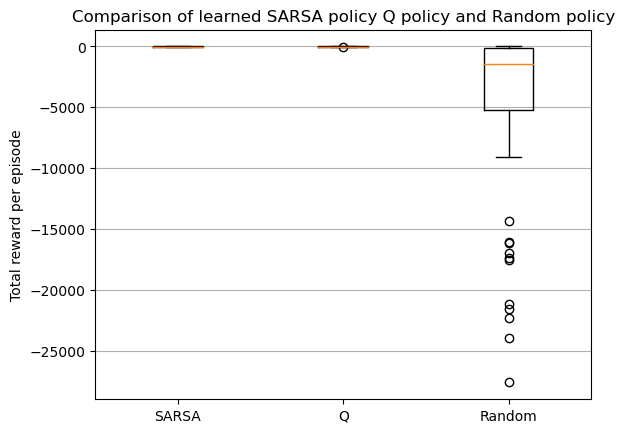

In [124]:
# Box plot to compare the distribution of total rewards per episode that each Agent has obtained during the evaluation episodes
plt.boxplot([sarsa_rewards_eval, q_rewards_eval, random_rewards_eval], labels = ["SARSA", "Q" ,"Random"])
plt.ylabel("Total reward per episode")
plt.title("Comparison of learned SARSA policy Q policy and Random policy")
plt.grid(True, axis = 'y')
plt.show()

Once trained, the agents have been evaluated by running several test episodes starting from different initial states, using only their learned policies (pure greedy action selection, with no further learning). This evaluation allows us to assess how well each agent exploits the knowledge acquired during training to efficiently reach the goal.

On the one hand, selecting the best performing SARSA agent with
$\gamma = 0.95$ and $\alpha = 0.1$, the results obtained during evaluation are very good.
The animation of an example episode shows how, starting from an arbitrary position, the agent is able to take consistent and purposeful steps that quickly move it toward the goal. The mean accumulated reward over the evaluation episodes is approximately −5.68, indicating that, regardless of the starting state, the agent reliably reaches the goal in a small number of steps. This behavior is also reflected in the box plot, where the total reward per episode is close to zero and exhibits very low variance, showing that the SARSA agent has learned a stable and effective policy.

Similarly, the Q-learning agent, using the same parameter configuration, also demonstrates strong performance during evaluation. The agent follows trajectories that efficiently approach the goal, and its mean accumulated reward over the evaluation episodes is −6.86, which is very close to the performance achieved by SARSA. As shown in the box plot, the Q-learning agent also exhibits low variance in the total reward per episode, indicating that the learned policy is robust across different initial states. 

Hence, the difference in mean reward for the SARSA and Q Learning algorithms suggests that both algorithms converge to near-oprimal behaviour in this environment, and that in this context the on-policy algorithm (SARSA) slightly outperforms the off-policy one (Q-learning). In fact, in Q-learning it is possible to observe a slightly higher variability in some episodes, but overall this difference is marginal once the training has converged. 
This behavior reflects the theoretical difference between on-policy and off-policy learning: SARSA accounts for exploration in its updates, resulting in slightly more stable performance, whereas Q-learning learns toward a greedy target and shows marginally higher variability.

The Random agent exhibits a completely different behavior. The animation of a sample episode shows a chaotic trajectory, with random actions taken at each time step and no clear tendency toward the goal. In most cases, the episode terminates due to the time limit rather than reaching the goal. This is reflected in the mean accumulated reward of approximately −5463.72, which is orders of magnitude worse than the rewards obtained by the learned agents. The box plot further highlights this behavior, showing a very large spread in accumulated rewards, with extremely negative values in many episodes. Occasionally, the random policy may reach the goal by chance, but this happens inconsistently and without any reliable strategy.

Overall, both the SARSA and Q-learning agents learn effective and goal-directed policies, clearly outperforming the random policy, which lacks any structured behavior. These results confirm that the learned value functions successfully capture the structure of the environment and guide the agent toward near-optimal behavior.

### 4. Implement your agent for DQN
---

Now we want to implement an agent for a deep RL algorithm DQN, and compare it with the other two algorithms.

4.1 DQN uses two deep neural networks for training. A policy and a target network. Here we're defining the network architecture. You can just use the network as provided by us. But feel welcome to play around with changing the number of nodes per layers, the activation functions or the layers themselves. However, whether you play with the network or not will not affect your grade.

In [11]:
# Provided DQN Architecture
# PyTorch Q-network skeleton

class QNetwork(nn.Module):
    def __init__(self, input_dim, n_actions):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(input_dim, 64),
            nn.ReLU(),
            nn.Linear(64, 32),
            nn.ReLU(),
            nn.Linear(32, 16),
            nn.ReLU(),
            nn.Linear(16, n_actions)
        )
        
    def forward(self, x):
        return self.net(x)


**4.2 Replay Buffer (0.5 points)**

In DQN, we use a replay buffer. The Replay Buffer stores and manages experiences (state, action, reward, next_state, done[has terminated]) so the agent can learn from them multiple times.

You will implement two methods:
  - push method to store an experience in the buffer
  - sample method to return a batch of experiences, i.e., (states, actions, rewards, next_states, dones)

In [12]:

class ReplayBuffer:
    def __init__(self, capacity):
        self.capacity = capacity
        self.buffer = deque(maxlen=capacity)

    # push a transition to the memory (buffer)
    def push(self, state, action, reward, next_state, done):
        # TO BE FILLED.
        # Creating a tuple with the interaction experience of each time step of an episode
        experienced_transition = (state, action, reward, next_state, done)
        # Appending this experience to the buffer ("database" that will store all the experiences)
        self.buffer.append(experienced_transition)

    # randomly sample a batch of consecutive experiences; please convert to numpy array for later training
    def sample(self, batch_size):
        # TO BE FILLED.
        # Selecting a random number and sample of experiences from the buffer container (without replacement)
        batch = random.sample(self.buffer, batch_size)
        # Getting each variable (column of the batch of tuples)
        states, actions, rewards, next_states, dones = zip(*batch)
        # Converting the set of each kind of variables to numpy arrays as indicated
        states = np.array(states)
        actions = np.array(actions)
        rewards = np.array(rewards) #, dtype = np.float32)
        next_states = np.array(next_states)
        dones = np.array(dones) #, dtype = np.bool_)
        
        return states, actions, rewards, next_states, dones


    def __len__(self):
        return len(self.buffer)

While DQN can learn from continuous features, in our target task, learning from just x and y coordinate makes DQN very data hungry. To decrease the training load, we use a Radial Basis Function to embed the x and y coordinates. A Radial Basis Function transforms a distance to a value between 0 and 1 (with 1 meaning the distance is 0 and 0 meaning the distance is infinity). We use 9 points sampled across the input space as references and transform a position (x,y) into a vector containing 9 values between 0 and 1 by using the Gaussian kernel to transform distances.

In this way, we are enriching the feature and transforming a 2D input into a 9D input with continuous and smooth values. There is no need to implement this function. Please use this function to embed the states before feeding them to DQN. This enables DQN to learn faster with fewer data. 

REMARK: Using a Radial Basis Function to embed the 2D coordinates as a similar approach to using a CNN to embed an image. This will not be covered in the exams!


In [13]:
# --- Define RBF Hyperparameters ---
N_CENTERS_PER_DIM = 3 # This will create 3x3 = 9 centers
RBF_STATE_DIM = N_CENTERS_PER_DIM * N_CENTERS_PER_DIM # New state_dim = 9

X_RANGE = Boundary.EAST - Boundary.WEST
Y_RANGE = Boundary.NORTH - Boundary.SOUTH

# Create a 3x3 grid of centers
x_centers = np.linspace(Boundary.WEST + X_RANGE/4, Boundary.EAST - X_RANGE/4, N_CENTERS_PER_DIM)
y_centers = np.linspace(Boundary.SOUTH + Y_RANGE/4, Boundary.NORTH - Y_RANGE/4, N_CENTERS_PER_DIM)

# Create a 9x2 array of (x, y) center coordinates
RBF_CENTERS = np.array(np.meshgrid(x_centers, y_centers)).T.reshape(-1, 2)


# Define the "width" of the gaussian kernels
RBF_SIGMA = (X_RANGE / N_CENTERS_PER_DIM) * 0.5

print(f"Using {RBF_STATE_DIM} RBF features (centers) with sigma={RBF_SIGMA:.2f}")

# --- RBF embedding function ---
def embed_state_rbf(state):
    """
    Calculates the 'closeness' (Gaussian) to each RBF center.
    """
    state_vec = np.array(state, dtype=np.float32) # [x, y]

    # Calculate squared distance from state to centers
    sq_distances = np.sum((state_vec - RBF_CENTERS)**2, axis=1)

    # Apply the Gaussian (bell curve) formula
    # exp(-dist^2 / (2 * sigma^2))
    features = np.exp(-sq_distances / (2 * RBF_SIGMA**2))

    return features.astype(np.float32)

Using 9 RBF features (centers) with sigma=24.00


**4.3: DQN** 

Now you are ready to define the DQN agent.
Please implement the following methods (**2 points**):

- select_action
- learn
- run_episode_dqn

Note that you should use the embed_state_rbf() method to embed states.

In [14]:
class DQNAgent(Agent):
    def __init__(self, state_dim, n_actions, gamma, epsilon_start, epsilon_end, epsilon_decay, learning_rate, buffer_size, batch_size, target_update_freq):
        # Note: We pass learning_rate as 'alpha' and epsilon_start as 'epsilon'
        # state_dim : dimension of the (embedded) input space
        # n_action : number of actions the agent can take
        # gamma: discount factor
        # epsilon_end: we will decrease epsilon over time, epsilon_end is the minimal epsilon value
        # epsilon_decay: how much we will decrease epsilon with each update
        # batch_size: how many consecutive are use for one training update
        # target_update_freq: the frequency with which the target net is updated
        super().__init__(alpha=learning_rate, gamma=gamma, epsilon=epsilon_start)

        self.state_dim = state_dim
        self.n_actions = n_actions
        self.gamma = gamma
        self.epsilon = epsilon_start
        self.epsilon_end = epsilon_end
        self.epsilon_decay = epsilon_decay
        self.learning_rate = learning_rate
        self.buffer_size = buffer_size
        self.batch_size = batch_size
        self.target_update_freq = target_update_freq

        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        print(f"Using device: {self.device}")

        self.policy_net = QNetwork(state_dim, n_actions).to(self.device)
        self.target_net = QNetwork(state_dim, n_actions).to(self.device)
        self.target_net.load_state_dict(self.policy_net.state_dict())
        self.target_net.eval()

        self.optimizer = optim.Adam(self.policy_net.parameters(), lr=self.learning_rate)
        self.memory = ReplayBuffer(self.buffer_size)

        self.steps_done = 0
        self.episode_rewards = []

    def __del__(self):
        # Clean up CUDA memory if used
        if self.device.type == 'cuda':
            torch.cuda.empty_cache()

    def values(self, state):
        # Gets Q-values for a state that is embedded.
        with torch.no_grad():
            state_tensor = torch.FloatTensor(state).unsqueeze(0).to(self.device)
            q_values_tensor = self.policy_net(state_tensor)
            return q_values_tensor.cpu().numpy().flatten()

    def value(self, state, action):
        # Get Q-value for a specific state-action pair
        q_values = self.values(state)
        return q_values[action]


    def set_value(self, state: State, action: Actions, value: float):
        # This method is for tabular agents, not directly applicable to DQN
        # We can't directly set a weight for a single state-action pair
        pass

    # Choose an action for the given state.
    # Returns the choosen action
    def select_action(self, state, use_greedy_strategy=False):
        # TO BE FILLED.
        # For the pure greedy policy (no exploration) (which will be used when evaluating)
        if use_greedy_strategy == True:
            # Apply the own NN function that obtains the output of the NN which are the q-values for a given state, and all the different action options
            q_values = self.values(state)
            # The selected action in this case is just the one with the highest value for this state
            best_action = int(np.argmax(q_values))
        # For the epsilon greedy policy (with exploration) (which will be used during training)
        elif use_greedy_strategy == False:
    
            # Generate a random uniform number to decide if greedy action or random action is selected in this step (run = call of this agent)
            u = np.random.uniform(0,1)

            # Greedy action: select with probab (1-eps) the best possible action to take in the situation of being in this particular state
            if u <= (1 - self.epsilon):
                # Apply the own NN function that obtains the output of the NN which are the q-values for a given state, and all the different action options
                q_values = self.values(state)
                # Keeping the action that gives the best (higher) q-value in this state
                best_action = int(np.argmax(q_values))

            # Random action: select with probab (eps) one among all possible actions randomly
            elif u > (1 - self.epsilon):
                best_action = int(np.random.randint(self.n_actions)) # the function in the return will pick randomly one among all possible
                 
        return best_action  

    # This function takes in a transition and saves it to the memory.
    # Note that you can only learn, if the memory has at least as many saved experiences as the batch size.
    # Think carefully about the roles of the target and the policy network and when to update which
    # You should use torch.nn.MSELoss() to compute the loss, and the optimizer that is part of the agent (self.optimizer)
    def learn(self, state, action, reward, next_state, done):

        # TO BE FILLED.
        # Save the transition step to memory (to the memory object of the Buffer class we created applying the push function we defined!)
        self.memory.push(state, action, reward, next_state, done)  # the push method will convert this variables to tuple and append them to the buffer as a new register
        
        # If there are not enough registers for selecting a batch, the training does not occur yet
        if len(self.memory) < self.batch_size:
            # Epsilon decay is made no matter what
            self.epsilon = max(self.epsilon_end, self.epsilon - self.epsilon_decay)
            return None
        elif len(self.memory) >= self.batch_size:
            # Sample a batch of experiences, applying the sample functionality of the buffer class we defined before
            states, actions, rewards, next_states, dones = self.memory.sample(self.batch_size)
            # Transform everthing to tensors in the adequate device
            states_t = torch.FloatTensor(states).to(self.device)         # (B, state_dim)
            next_states_t = torch.FloatTensor(next_states).to(self.device)    # (B, state_dim)
            actions_t = torch.LongTensor(actions).unsqueeze(1).to(self.device)  # (B, 1)
            rewards_t = torch.FloatTensor(rewards).to(self.device)        # (B,)
            dones_t = torch.FloatTensor(dones.astype(np.float32)).to(self.device) # (B,)
            # Compute Q(s,a)
            q_values = self.policy_net(states_t)              # (B, n_actions)
            state_action_values = q_values.gather(1, actions_t).squeeze(1)  # (B,)
            # Q-target: r + gamma * max_a' Q_target(s', a') * (1 - done)
            with torch.no_grad():
                next_q_values = self.target_net(next_states_t)         # (B, n_actions)
                max_next_q_values, _ = next_q_values.max(dim=1)       # (B,)
                target_values = rewards_t + self.gamma * max_next_q_values * (1.0 - dones_t) # to avoid doing this when we are done (dones_t = 1)
            #Calculate MSE and perform backpropagation
            loss_fn = torch.nn.MSELoss()
            loss = loss_fn(state_action_values, target_values)
            self.optimizer.zero_grad()
            loss.backward()
            self.optimizer.step()
            self.steps_done += 1
            if self.steps_done % self.target_update_freq == 0: # each target_upddate_freq number of steps, update the weights into the target network (using a different network to compute the targets, and another networ to compute the function approximation values of each step)
                self.target_net.load_state_dict(self.policy_net.state_dict())   
            
            # Decay epsilon
            self.epsilon = max(self.epsilon_end, self.epsilon - self.epsilon_decay)

        return None


    def state_value(self, state):
        """
        Returns the state-value V(s) = max_a Q(s,a)
        Used by Agent.plot_state_values()
        """
        q = self.values(state)
        return float(np.max(q))

    def plot_state_values(self, stride=1):
        self.v = np.zeros(
            ((Boundary.SOUTH - Boundary.NORTH + stride) // stride, (Boundary.EAST - Boundary.WEST + stride) // stride))
        for j, x in enumerate(range(Boundary.WEST, Boundary.EAST + 1, stride)):
            for i, y in enumerate(range(Boundary.NORTH, Boundary.SOUTH + 1, stride)):
                self.v[i, j] = self.state_value(embed_state_rbf((x, y)))

        plt.imshow(self.v)
        plt.colorbar()
        return plt.show()


In [15]:
# This method is what you may use to train the agent for one episode. You need to set-up the environment. 
# Until the episode terminates the agent should interact with the environment. 
# is_learning and is_rendering indicate if the agent should also learn (update weights) and if the data for antimating the episode should be collected and returned. 
# In that case make sure to save env.render(), env.time, the previous state, the new state, the choosen action and the total reward for every timestep.

def run_episode_dqn(env, agent, is_learning=True, is_rendering=False):
    state = env.reset()
    state = np.array(state, dtype=np.float32)
    state = embed_state_rbf(state) # embed state
    total_reward = 0.0
    done = False
    animation_data = []

    if is_rendering:
        animation_data.append((env.render(), env.time, None, state, None, 0))

    while not done:
        # TO BE FILLED.
        # Select an action (during training, we use the epsilon greedy strategy)
        prev_raw_state = env.state
        action = agent.select_action(state, use_greedy_strategy = not is_learning)
        
        # Interacition with environment
        next_state, reward, done, _ = env.step(action)
        
        # Converting the states returned by the environment into a valid format to feed the NN
        next_state = np.array(next_state, dtype = np.float32)
        next_state_emb = embed_state_rbf(next_state)
        
        # Accumulating the total reward of the episode at each step
        total_reward = total_reward + reward
        
        # Learning if its the case
        if is_learning == True:
            # Applying the learn function of the Agent
            agent.learn(state, action, reward, next_state_emb, done)
            
        # In case that we want to save the data to render an animation
        if is_rendering == True:
            # Applying the render function of our environment class
            img = env.render()
            # Gathering the animation data of each step
            animation_data.append((img, env.time, prev_raw_state, tuple(next_state.astype(int)), action, total_reward))

        # Updating the state for the next time-step of the episode
        state = next_state_emb
        
    return total_reward, animation_data # Return total_reward

**4.4 Run the simulation, play with parameters and analyse results (1 point)**

Now it's time to train and evaluate DQN algorithm/agent on the environment. 
Similar with the other two algorithms, in the simulations, please plot the measure of DQN's performance. 
You shall play with two parameters: stepsize (learning rate) $\alpha$ and update frequency of target network ($c$ in the slides), and find good values for them. During the experiments, you can stick with the values provided below for the remaining hyperparameters.

There is no need to submit your code for this answer. Please provide the final plots of learning performance for DQN with different parameters.

Tips: When training the DQN agent, you can use a warm-up stage to fill up the memory of this agent with experiences (following the random policy) to speed up the training process. You may also plot the state values to see how the agent learns over time.


In [16]:
num_episodes_dqn = 4000
gamma_dqn = 0.99
epsilon_start_dqn = 1.0
epsilon_end_dqn = 0.05
epsilon_decay_dqn = (epsilon_start_dqn - epsilon_end_dqn) / (num_episodes_dqn * 0.9) # Decay over 90% of episodes

buffer_size_dqn = 10000
batch_size_dqn = 64

num_seed_dqn = 42


learning_rate_dqn = [1e-3, 5e-4]
target_update_freq_dqn = [500, 1000]

np.random.seed(num_seed_dqn)
random.seed(num_seed_dqn)
torch.manual_seed(num_seed_dqn)

env = Environment()

dqn_rewards = {}  
dqn_agents  = {}

for lr in learning_rate_dqn:
    for tgt_freq in target_update_freq_dqn:
        print(f"\nTraining DQN with lr={lr}, target_update_freq={tgt_freq}")

        # Crear agente DQN
        agent = DQNAgent(
            state_dim=RBF_STATE_DIM,       # = 9
            n_actions=len(Actions),
            gamma=gamma_dqn,
            epsilon_start=epsilon_start_dqn,
            epsilon_end=epsilon_end_dqn,
            epsilon_decay=epsilon_decay_dqn,
            learning_rate=lr,
            buffer_size=buffer_size_dqn,
            batch_size=batch_size_dqn,
            target_update_freq=tgt_freq
        )

        episode_rewards = []

        # Train again the buffer with random policy
        warmup_episodes = 10
        for _ in range(warmup_episodes):
            run_episode_dqn(env, agent, is_learning=False, is_rendering=False) 

        # Main training 
        for ep in range(num_episodes_dqn):
            total_reward, _ = run_episode_dqn(env, agent, is_learning=True, is_rendering=False)
            episode_rewards.append(total_reward)

            if (ep + 1) % 100 == 0:
                print(f"Episode {ep+1}/{num_episodes_dqn} - mean last 100 reward: {np.mean(episode_rewards[-100:]):.2f}")

        dqn_rewards[(lr, tgt_freq)] = episode_rewards
        dqn_agents[(lr, tgt_freq)] = agent


Training DQN with lr=0.001, target_update_freq=500
Using device: cpu
Episode 100/4000 - mean last 100 reward: -14696.54
Episode 200/4000 - mean last 100 reward: -21170.73
Episode 300/4000 - mean last 100 reward: -22001.48
Episode 400/4000 - mean last 100 reward: -7045.84
Episode 500/4000 - mean last 100 reward: -4256.44
Episode 600/4000 - mean last 100 reward: -159.76
Episode 700/4000 - mean last 100 reward: -55.13
Episode 800/4000 - mean last 100 reward: -29.18
Episode 900/4000 - mean last 100 reward: -22.11
Episode 1000/4000 - mean last 100 reward: -7.45
Episode 1100/4000 - mean last 100 reward: -39.62
Episode 1200/4000 - mean last 100 reward: -717.25
Episode 1300/4000 - mean last 100 reward: -5.32
Episode 1400/4000 - mean last 100 reward: -16.98
Episode 1500/4000 - mean last 100 reward: -11.86
Episode 1600/4000 - mean last 100 reward: -35.38
Episode 1700/4000 - mean last 100 reward: -5.66
Episode 1800/4000 - mean last 100 reward: -25.57
Episode 1900/4000 - mean last 100 reward: -10

Please add your final plots here and explain your observations. 

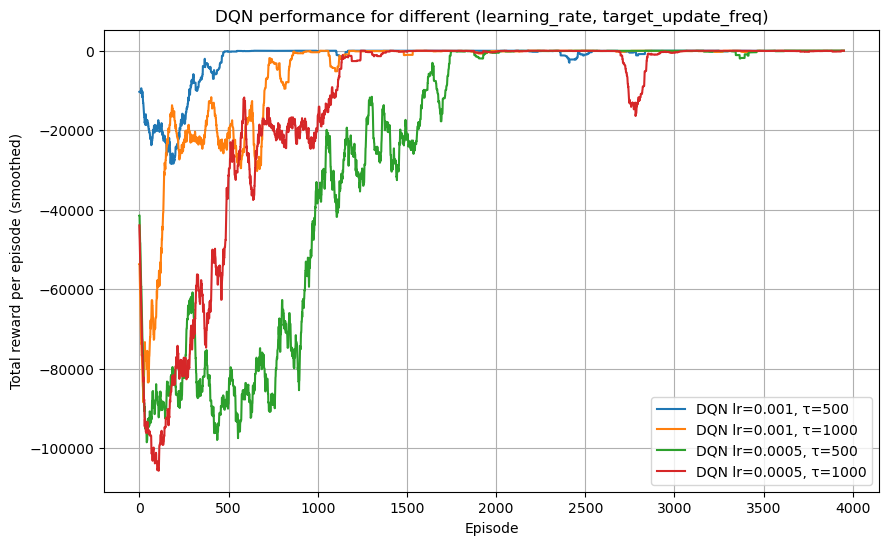

In [17]:
plt.figure(figsize=(10,6))
for (lr, tgt_freq), rewards in dqn_rewards.items():
    smoothed = smooth(rewards, 50)
    label = f"DQN lr={lr}, τ={tgt_freq}"
    plt.plot(smoothed, label=label)

plt.xlabel("Episode")
plt.ylabel("Total reward per episode (smoothed)")
plt.title("DQN performance for different (learning_rate, target_update_freq)")
plt.legend()
plt.grid(True)
plt.show()


The figure shows the learning performance of the DQN agent trained with different combinations of learning rate
$\alpha \in \{1\times10^{-3}, 5\times10^{-4}\}$ and target network update frequency
$\tau \in \{500, 1000\}$.
The curves represent the smoothed total accumulated reward per episode, where values closer to zero indicate better performance.

It is clear from the plot that the learning rate has a strong influence on the speed of learning.
In fact, the agents that were trained with the higher learning rate $\alpha = 1\times10^{-3}$ (<font color = 'lightblue'>blue </font> and <font color = 'orange'> orange </font> curves) generally learn faster, showing a rapid improvement in accumulated reward during the early training phase. These agents reach near-optimal performance in fewer episodes, indicating that a larger step size allows the neural network to adapt more quickly to the observed transitions.

In contrast, agents trained with the smaller learning rate $\alpha = 5\times10^{-4}$ (<font color = 'green'> green </font> and <font color = 'red'> red </font> curves) exhibit a slower learning process. In particular, they show poor performance during the early stages, with extremely negative accumulated rewards, before gradually improving over time. This indicates that a learning rate that is too small makes it difficult for the DQN to efficiently update its parameters, especially in the presence of noisy gradients during early exploration.

The target network update frequency $\tau$ mainly affects the stability of learning.
Using a larger update frequency ($\tau = 1000$) generally leads to smoother and more stable learning curves, as the target network changes less frequently, providing a more stable target for the Q-value updates. This effect is particularly visible for the smaller learning rate, the increase helps reduce oscillations and improves convergence behavior.

Combining these observations, the best performance with the values that were considered is achieved with $\alpha = 1\times10^{-3}$ and $\tau = 500$, which converges quickly and remains stable once near-optimal performance is reached. The configuration with $\alpha = 1\times10^{-3}$ and $\tau = 1000$ also performs well, but converges slightly more slowly.

Overall, these results highlight the importance of balancing learning speed and stability in DQN. A sufficiently large learning rate is crucial for efficient training, while an appropriate target network update frequency helps stabilize learning and prevent large oscillations. When properly tuned, the DQN agent is able to learn an effective policy and reach performance comparable to the tabular agents using function approximation.

**4.5 Finally, let us compare DQN with Semi-gradient SARSA and Q-learning (1.5 points)**

We require you to train all three algorithms together, compare their learning processes and explain the final learned policies.

**You do not need to submit your code for this question**. Please provide one plot that shows the learning curves of all three algorithms, and then explain your observations. To understand the learned policy, please use the code below to visualize the learned policy for agents, explaining the learned policy and arguing whether it is optimal.

Some questions you shall think about and answer (in case there are no differences or no special things, just indicate what you observed):
- How do the learning procedures of the three algorithms differ?
- What strategy does each RL agent appear to have learned? How is the final learned policy of the three algorithms different (or similar)? - When do we use different algorithms?


Put your plots for the learning procedure and final learned policies here.


Explain your answers. 

Here are the codes you can use to visualize the learned policy. For each possible state, the greedy policy is visualized.


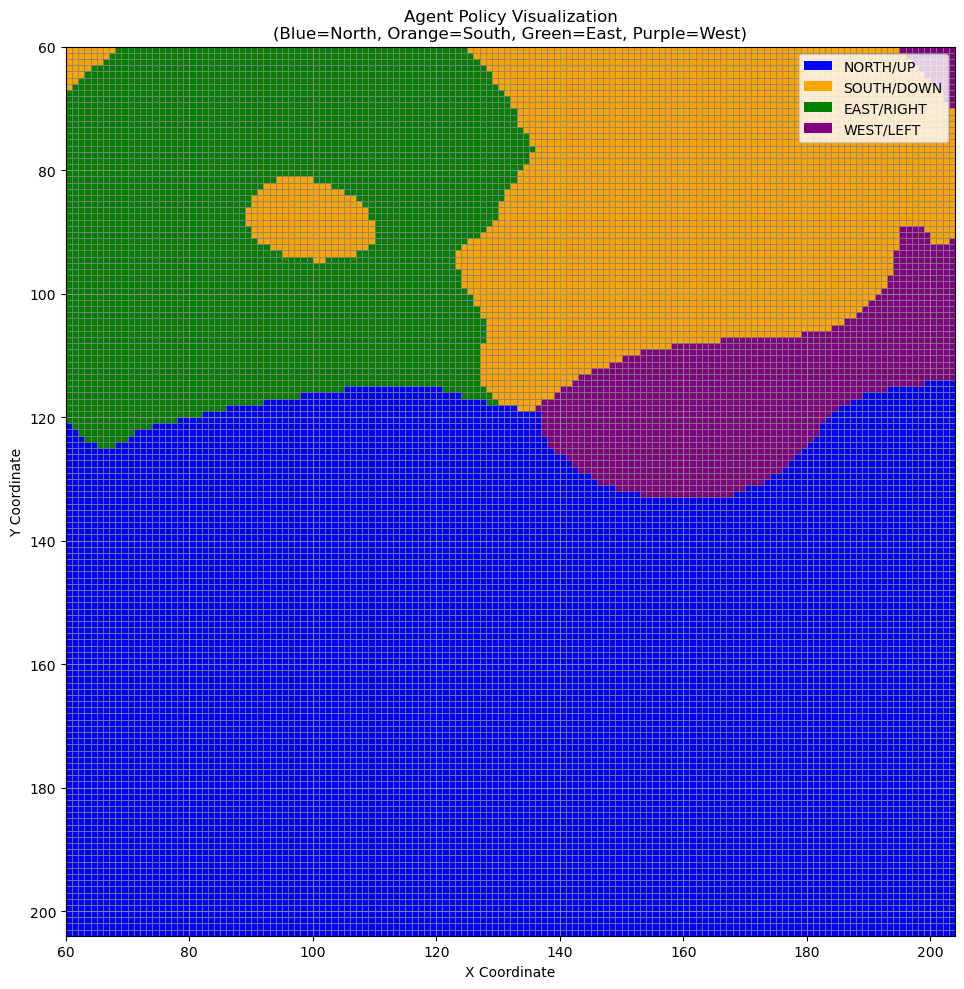

In [18]:
def plot_agent_policy(agent, stride=1, dqn_agent=True):

    # Plot the agent's policy for each state in the grid.

    # Create figure
    fig, ax = plt.subplots(figsize=(12, 10))

    # Prepare the grid
    x_coords = range(60, 205, stride)
    y_coords = range(60, 205, stride)

    # Create arrays to store actions and colors
    action_grid = np.zeros((len(y_coords), len(x_coords)), dtype=int)
    color_grid = np.empty((len(y_coords), len(x_coords)), dtype=object)

    # Map actions to colors
    action_colors = {
        Actions.NORTH: 'blue',    # NORTH = BLUE
        Actions.SOUTH: 'orange',     # SOUTH = ORANGE
        Actions.EAST: 'green',        # EAST = GREEN
        Actions.WEST: 'purple'       # WEST = PURPLE
    }

    # For each state, get the greedy action
    for i, y in enumerate(y_coords):
        for j, x in enumerate(x_coords):
            # Embed the state
            if dqn_agent:
                embedded_state = embed_state_rbf((x, y))
            else:
                embedded_state = (x,y)

            # Get greedy action
            action = agent.select_action(embedded_state, use_greedy_strategy=True)

            action_grid[i, j] = action
            color_grid[i, j] = action_colors[action]

    # Create the plot
    for i, y in enumerate(y_coords):
        for j, x in enumerate(x_coords):
            ax.add_patch(plt.Rectangle((x, y), stride, stride,
                                     facecolor=color_grid[i, j],
                                     edgecolor='gray',
                                     linewidth=0.5))

    # Set plot properties
    ax.set_xlim(60, 204)
    ax.set_ylim(204, 60)
    ax.set_aspect('equal')
    ax.set_xlabel('X Coordinate')
    ax.set_ylabel('Y Coordinate')
    ax.set_title('Agent Policy Visualization\n(Blue=North, Orange=South, Green=East, Purple=West)')

    # Create legend

    legend_elements = [
        Patch(facecolor='blue', label='NORTH/UP'),
        Patch(facecolor='orange', label='SOUTH/DOWN'),
        Patch(facecolor='green', label='EAST/RIGHT'),
        Patch(facecolor='purple', label='WEST/LEFT')
    ]
    ax.legend(handles=legend_elements, loc='upper right')

    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    return plt.show()

plot_agent_policy(agent, stride=1)

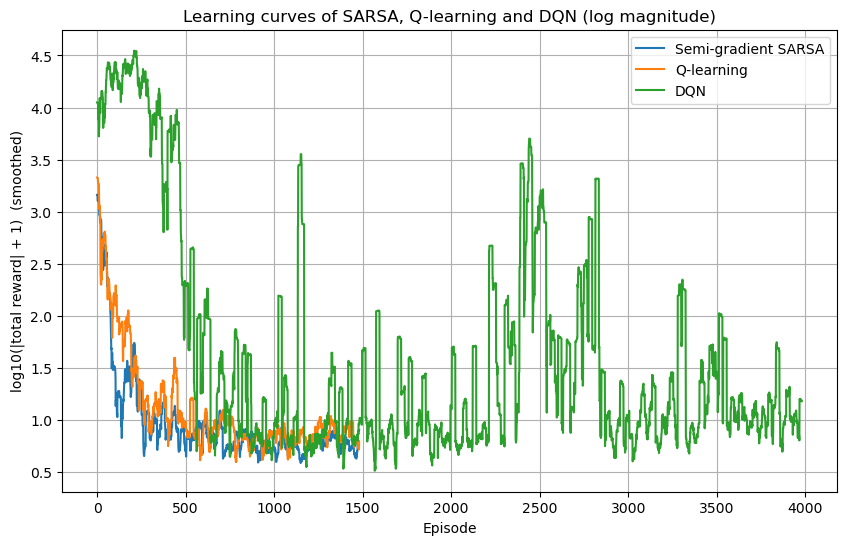

In [19]:
best_sarsa_curve = sarsa_rewards[(0.95, 0.1)]
best_q_curve     = q_rewards[(0.95, 0.1)]
best_dqn_curve   = dqn_rewards[(1e-3, 500)]

s_sarsa = smooth(best_sarsa_curve, 20)
s_q     = smooth(best_q_curve, 20)
s_dqn   = smooth(best_dqn_curve, 20)

plt.figure(figsize=(10,6))

# Plot log10 of |reward|. Add 1 to avoid log(0).
plt.plot(np.log10(np.abs(s_sarsa) + 1), label="Semi-gradient SARSA")
plt.plot(np.log10(np.abs(s_q)     + 1), label="Q-learning")
plt.plot(np.log10(np.abs(s_dqn)   + 1), label="DQN")

plt.xlabel("Episode")
plt.ylabel("log10(|total reward| + 1)  (smoothed)")
plt.title("Learning curves of SARSA, Q-learning and DQN (log magnitude)")
plt.legend()
plt.grid(True)
plt.show()

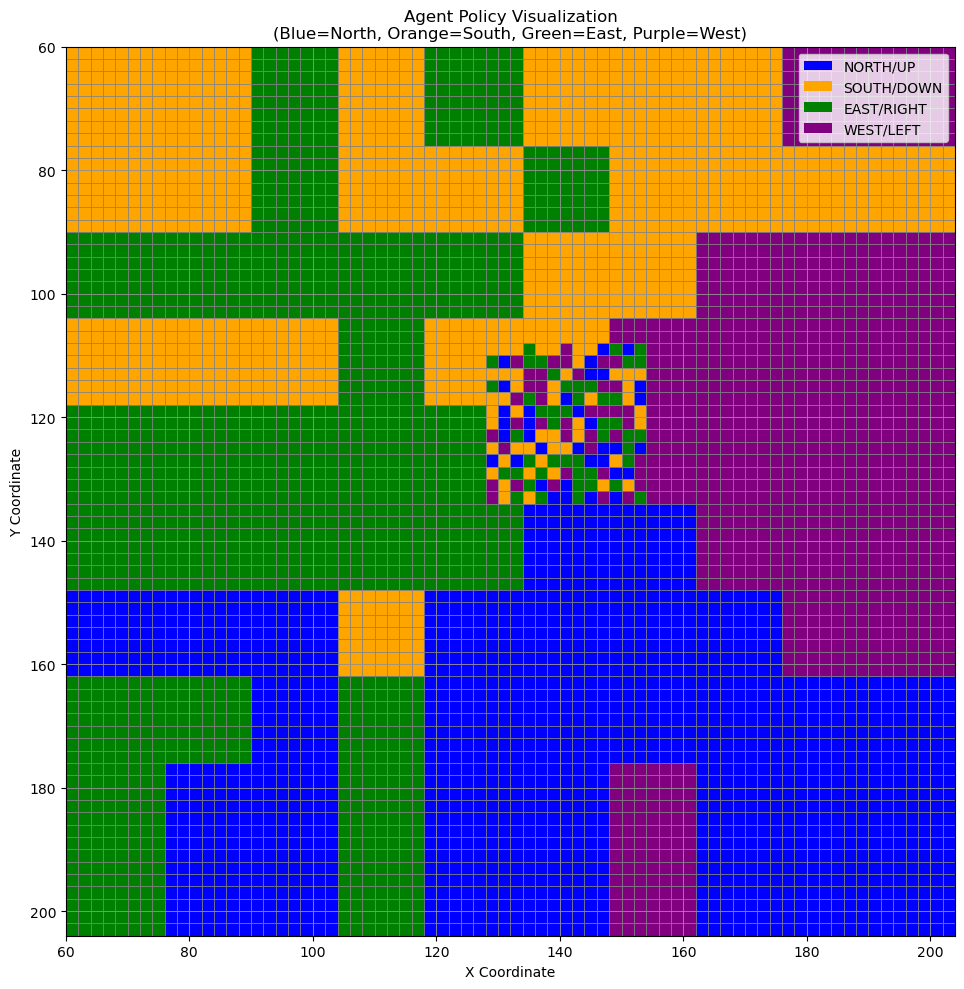

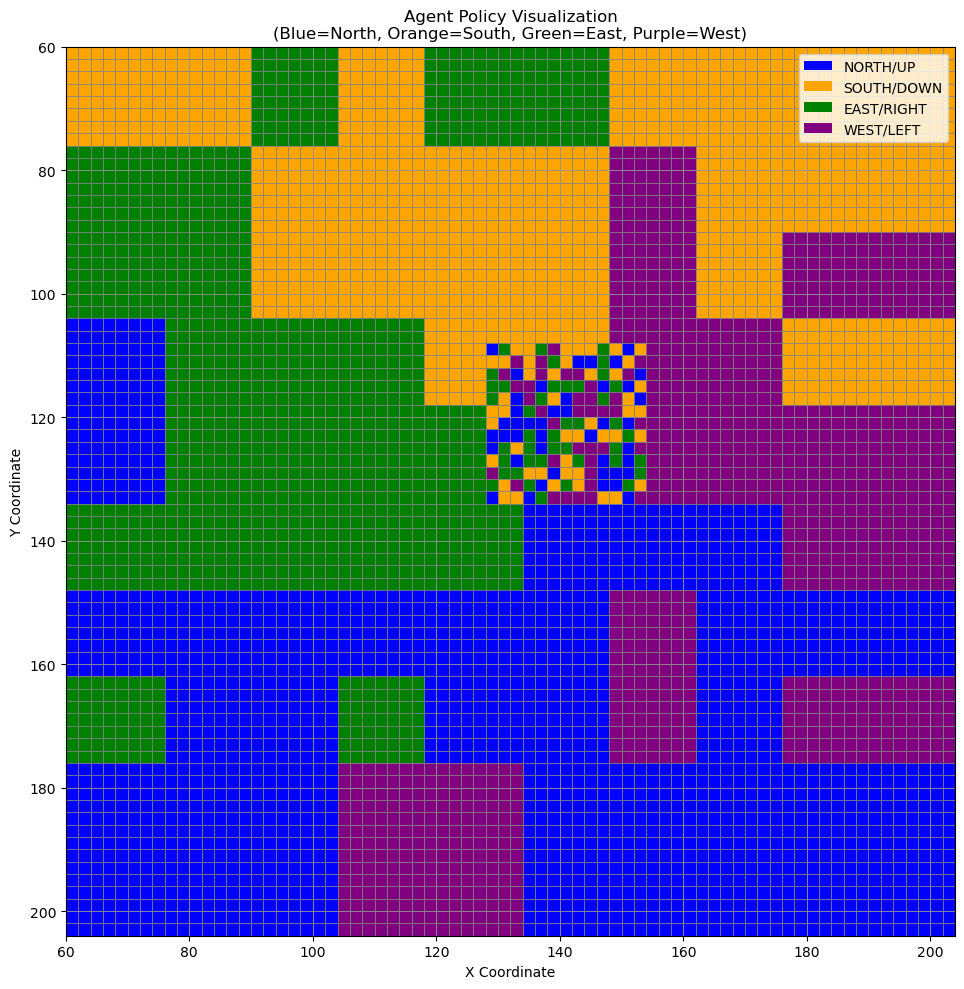

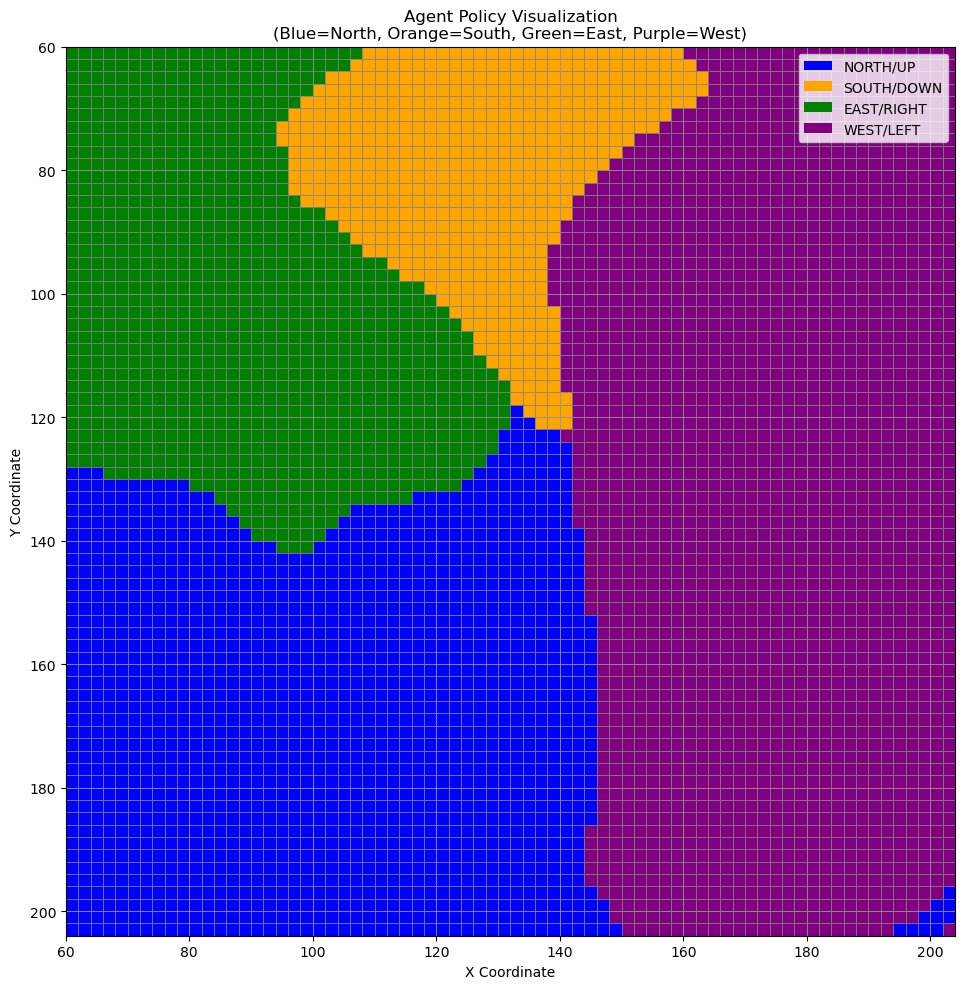

In [25]:
best_dqn_agent = dqn_agents[(1e-3, 500)]
plot_agent_policy(best_sarsa_agent, stride=2, dqn_agent=False)
plot_agent_policy(best_Q_agent,     stride=2, dqn_agent=False)
plot_agent_policy(best_dqn_agent,   stride=2, dqn_agent=True)

In the first graph above, the learning curves for semi-gradient SARSA, Q-learning, and DQN are plotted. It is clear that the three algorithms exhibit different learning dynamics. In particular, semi-gradient SARSA and Q-learning have similar learning curves, both converging relatively quickly and reaching a stable regime much sooner than DQN. This behavior is due to the way these algorithms perform their learning updates.

In particular, Q-learning and SARSA are instances of off-policy and on-policy algorithms, respectively. The former learns toward a greedy target independently of the behavior policy, while the latter learns a policy that explicitly accounts for the exploratory behavior. This makes SARSA’s convergence slightly slower but more stable compared to Q-learning.

In contrast, DQN shows a very different behavior compared to both algorithms. The agent exhibits extremely large negative rewards as well as strong oscillations, which is clearly visible in the early and intermediate phases of training. This reflects the higher complexity of the learning process: DQN must learn a non-linear function approximation using a neural network, while managing the replay buffer and stabilizing training through the use of a target network. As training progresses, the curve eventually improves and reaches a regime that is more similar to that of SARSA and Q-learning, although it still exhibits higher variability.

Turning to the learned policies, the three graphs above show the learned policies for SARSA, Q-learning, and DQN, respectively.

In the first case, the SARSA visualization shows a coherent and structured behavior across the state space. The policy is goal-directed, in the sense that from most regions the selected actions move the agent toward the region where the goal is located. Once the agent reaches the area near the goal, more variability is visible, which is expected due to function approximation and the on-policy nature of SARSA.

A very similar policy visualization appears for the Q-learning algorithm, indicating that both algorithms have learned very similar strategies, namely moving in directions that reduce the distance to the goal and then, once near it, following a more variable local action pattern.

On the other hand, the DQN policy visualization appears much smoother, presenting clearer partitions of the state space. Instead of small, locally varying action regions, the policy forms large areas where the same actions are selected. This is a direct consequence of the neural network function approximation together with the RBF embedding, which encourages smooth generalization across nearby states. From almost any position, the agent is correctly guided toward the goal position.

Overall, these results illustrate the differences between the three algorithms. SARSA and Q-learning learn faster and more stably in this relatively small environment, while DQN requires significantly more training data and careful hyperparameter tuning, as well as the use of replay buffers and neural network updates, which make training slower and more data-hungry. Ultimately, in the context of a small environment, SARSA and Q-learning perform better than DQN. However, DQN is still able to learn a smooth and comparable policy, and its advantages become more evident in larger or more complex settings.

Well done! Before handing in, make sure that the code you hand in work, and that all plots are shown. 

Again, please name this file according to your last names.